In [151]:
import numpy as np
import pandas as pd
import xarray as xr
import glob
import os
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import cartopy.crs as ccrs
import cartopy.feature
from cartopy.util import add_cyclic_point
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.5  # previous pdf hatch linewidth



## Datos

In [2]:
path = '/home/tabu/Escritorio/Doctorado/ClimDinam/TP4/'
path1 = '/home/tabu/Escritorio/Doctorado/ClimDinam/TP1/'
path2 = '/media/tabu/JULIAexterno/climatologia_dinamica/'

In [3]:
#Observaciones -------------------------------
precip_obs =  xr.open_dataset(path1+'DATOS/precip.mon.total.v7_197601-200512_2.5_anu.nc')
precip_obs['pr'] = precip_obs.precip
climatologia = precip_obs.mean(dim='time')
time = precip_obs.time
timeattrs = precip_obs.time.attrs
time = xr.Dataset({'time':('time',time,timeattrs)})

mascara = precip_obs.precip/precip_obs.precip

/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


In [4]:
#etp
os.chdir(path2)
os.getcwd()
import os, fnmatch

listOfFiles = os.listdir(path2+'/CanESM5')
pattern_h = "etp*historical*r*p1*.nc"
etp_historical = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_h):
        etp_historical.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h1 = "etp*ssp126*r*p1*2020*.nc"
etp_ssp126_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h1):
        etp_ssp126_h1.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h2 = "etp*ssp126*r*p1*2070*.nc"
etp_ssp126_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h2):
        etp_ssp126_h2.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h1 = "etp*ssp585*r*p1*2020*.nc"
etp_ssp585_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h1):
        etp_ssp585_h1.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h2 = "etp*ssp585*r*p1*2070*.nc"
etp_ssp585_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h2):
        etp_ssp585_h2.append('CanESM5/'+entry)
        #print (entry)
            
etp_hist_ensmean = xr.open_dataset(path2+'/CanESM5/etp_Amon_CanESM5_historical_ensmeani1p1f1_2.5_anu.nc')
etp_ssp126_mean_h1 = xr.open_dataset(path2+'/CanESM5/etp_Amon_CanESM5_ssp126_ensmeani1p1f1_2020-2049_2.5_anu.nc')
etp_ssp126_mean_h2 = xr.open_dataset(path2+'/CanESM5/etp_Amon_CanESM5_ssp126_ensmeani1p1f1_2070-2099_2.5_anu.nc')
etp_ssp585_mean_h1 = xr.open_dataset(path2+'/CanESM5/etp_Amon_CanESM5_ssp585_ensmeani1p1f1_2020-2049_2.5_anu.nc')
etp_ssp585_mean_h2 = xr.open_dataset(path2+'/CanESM5/etp_Amon_CanESM5_ssp585_ensmeani1p1f1_2070-2099_2.5_anu.nc')

etp_hist = []
#Guardo el ensamble ya enmascarado
for file in etp_historical:
    etp = xr.open_dataset(path2+file)
    etp['time'] = time['time']
    etp['etp'] = etp.etp*mascara
    etp_hist.append(etp)

etp_126_h1 = []
#Guardo el ensamble ya enmascarado
for file in etp_ssp126_h1:
    etp = xr.open_dataset(path2+file)
    etp['time'] = time['time']
    etp['etp'] = etp.etp*mascara
    etp_126_h1.append(etp)
    
etp_126_h2 = []
#Guardo el ensamble ya enmascarado
for file in etp_ssp126_h2:
    etp = xr.open_dataset(path2+file)
    etp['time'] = time['time']
    etp['etp'] = etp.etp*mascara
    etp_126_h2.append(etp)
    
etp_585_h1 = []
#Guardo el ensamble ya enmascarado
for file in etp_ssp585_h1:
    etp = xr.open_dataset(path2+file)
    etp['time'] = time['time']
    etp['etp'] = etp.etp*mascara
    etp_585_h1.append(etp)
    
etp_585_h2 = []
#Guardo el ensamble ya enmascarado
for file in etp_ssp585_h2:
    etp = xr.open_dataset(path2+file)
    etp['time'] = time['time']
    etp['etp'] = etp.etp*mascara
    etp_585_h2.append(etp)

In [5]:
#tas
os.chdir(path2)
os.getcwd()
import os, fnmatch

listOfFiles = os.listdir(path2+'/CanESM5')
pattern_h = "tas*historical*r*p1*anu.nc"
tas_historical = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_h):
        tas_historical.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h1 = "tas*ssp126*r*p1*2020*anu.nc"
tas_ssp126_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h1):
        tas_ssp126_h1.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h2 = "tas*ssp126*r*p1*2070*anu.nc"
tas_ssp126_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h2):
        tas_ssp126_h2.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h1 = "tas*ssp585*r*p1*2020*anu.nc"
tas_ssp585_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h1):
        tas_ssp585_h1.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h2 = "tas*ssp585*r*p1*2070*anu.nc"
tas_ssp585_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h2):
        tas_ssp585_h2.append('CanESM5/'+entry)
        #print (entry)
            
tas_hist_ensmean = xr.open_dataset(path2+'/CanESM5/tas_Amon_CanESM5_historical_ensmeani1p1f1_2.5_anu.nc')
tas_ssp126_mean_h1 = xr.open_dataset(path2+'/CanESM5/tas_Amon_CanESM5_ssp126_ensmeani1p1f1_2020-2049_2.5_anu.nc')
tas_ssp126_mean_h2 = xr.open_dataset(path2+'/CanESM5/tas_Amon_CanESM5_ssp126_ensmeani1p1f1_2070-2099_2.5_anu.nc')
tas_ssp585_mean_h1 = xr.open_dataset(path2+'/CanESM5/tas_Amon_CanESM5_ssp585_ensmeani1p1f1_2020-2049_2.5_anu.nc')
tas_ssp585_mean_h2 = xr.open_dataset(path2+'/CanESM5/tas_Amon_CanESM5_ssp585_ensmeani1p1f1_2070-2099_2.5_anu.nc')

tas_hist = []
#Guardo el ensamble ya enmascarado
for file in tas_historical:
    tas = xr.open_dataset(path2+file)
    tas['time'] = time['time']
    tas['tas'] = tas.tas*mascara
    tas_hist.append(tas)

tas_126_h1 = []
#Guardo el ensamble ya enmascarado
for file in tas_ssp126_h1:
    tas = xr.open_dataset(path2+file)
    tas['time'] = time['time']
    tas['tas'] = tas.tas*mascara
    tas_126_h1.append(tas)
    
tas_126_h2 = []
#Guardo el ensamble ya enmascarado
for file in tas_ssp126_h2:
    tas = xr.open_dataset(path2+file)
    tas['time'] = time['time']
    tas['tas'] = tas.tas*mascara
    tas_126_h2.append(tas)
    
tas_585_h1 = []
#Guardo el ensamble ya enmascarado
for file in tas_ssp585_h1:
    tas = xr.open_dataset(path2+file)
    tas['time'] = time['time']
    tas['tas'] = tas.tas*mascara
    tas_585_h1.append(tas)
    
tas_585_h2 = []
#Guardo el ensamble ya enmascarado
for file in tas_ssp585_h2:
    tas = xr.open_dataset(path2+file)
    tas['time'] = time['time']
    tas['tas'] = tas.tas*mascara
    tas_585_h2.append(tas)

In [198]:
#evspsbl
os.chdir(path2)
os.getcwd()
import os, fnmatch

listOfFiles = os.listdir(path2+'/CanESM5')
pattern_h = "evspsbl*historical*r*p1*anu.nc"
ev_historical = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_h):
        ev_historical.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h1 = "evspsbl*ssp126*r*p1*2020*anu.nc"
ev_ssp126_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h1):
        ev_ssp126_h1.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h2 = "evspsbl*ssp126*r*p1*2070*anu.nc"
ev_ssp126_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h2):
        ev_ssp126_h2.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h1 = "evspsbl*ssp585*r*p1*2020*anu.nc"
ev_ssp585_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h1):
        ev_ssp585_h1.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h2 = "evspsbl*ssp585*r*p1*2070*anu.nc"
ev_ssp585_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h2):
        ev_ssp585_h2.append('CanESM5/'+entry)
        #print (entry)
            
ev_hist_ensmean = xr.open_dataset(path2+'/CanESM5/evspsbl_Amon_CanESM5_historical_ensmeani1p1f1_2.5_anu.nc')
ev_hist_ensmean['time'] = time['time']
ev_ssp126_mean_h1 = xr.open_dataset(path2+'/CanESM5/evspsbl_Amon_CanESM5_ssp126_ensmeani1p1f1_2020-2049_2.5_anu.nc')
ev_ssp126_mean_h1['time'] = time['time']
ev_ssp126_mean_h2 = xr.open_dataset(path2+'/CanESM5/evspsbl_Amon_CanESM5_ssp126_ensmeani1p1f1_2070-2099_2.5_anu.nc')
ev_ssp126_mean_h2['time'] = time['time']
ev_ssp585_mean_h1 = xr.open_dataset(path2+'/CanESM5/evspsbl_Amon_CanESM5_ssp585_ensmeani1p1f1_2020-2049_2.5_anu.nc')
ev_ssp585_mean_h1['time'] = time['time']
ev_ssp585_mean_h2 = xr.open_dataset(path2+'/CanESM5/evspsbl_Amon_CanESM5_ssp585_ensmeani1p1f1_2070-2099_2.5_anu.nc')
ev_ssp585_mean_h2['time'] = time['time']

ev_hist = []
#Guardo el ensamble ya enmascarado
for file in ev_historical:
    ev = xr.open_dataset(path2+file)
    ev['time'] = time['time']
    #ev['evspsbl'] = ev.evspsbl*mascara
    ev_hist.append(ev)

ev_126_h1 = []
#Guardo el ensamble ya enmascarado
for file in ev_ssp126_h1:
    ev = xr.open_dataset(path2+file)
    ev['time'] = time['time']
    #ev['evspsbl'] = ev.evspsbl*mascara
    ev_126_h1.append(ev)
    
ev_126_h2 = []
#Guardo el ensamble ya enmascarado
for file in ev_ssp126_h2:
    ev = xr.open_dataset(path2+file)
    ev['time'] = time['time']
    #ev['evspsbl'] = ev.evspsbl*mascara
    ev_126_h2.append(ev)
    
ev_585_h1 = []
#Guardo el ensamble ya enmascarado
for file in ev_ssp585_h1:
    ev = xr.open_dataset(path2+file)
    ev['time'] = time['time']
    #ev['evspsbl'] = ev.evspsbl*mascara
    ev_585_h1.append(ev)
    
ev_585_h2 = []
#Guardo el ensamble ya enmascarado
for file in ev_ssp585_h2:
    ev = xr.open_dataset(path2+file)
    ev['time'] = time['time']
    #ev['evspsbl'] = ev.evspsbl*mascara
    ev_585_h2.append(ev)

In [171]:
#pr
os.chdir(path2)
os.getcwd()
import os, fnmatch

listOfFiles = os.listdir(path2+'/CanESM5')
pattern_h = "pr*historical*r*p1*anu.nc"
pr_historical = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_h):
        pr_historical.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h1 = "pr*ssp126*r*p1*2020*anu.nc"
pr_ssp126_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h1):
        pr_ssp126_h1.append('CanESM5/'+entry)
        #print (entry)

pattern_ssp126_h2 = "pr*ssp126*r*p1*2070*anu.nc"
pr_ssp126_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp126_h2):
        pr_ssp126_h2.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h1 = "pr*ssp585*r*p1*2020*anu.nc"
pr_ssp585_h1 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h1):
        pr_ssp585_h1.append('CanESM5/'+entry)
        #print (entry)
            
pattern_ssp585_h2 = "pr*ssp585*r*p1*2070*anu.nc"
pr_ssp585_h2 = []
for entry in listOfFiles:
    if fnmatch.fnmatch(entry, pattern_ssp585_h2):
        pr_ssp585_h2.append('CanESM5/'+entry)
        #print (entry)
            
pr_hist_ensmean = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_historical_ensmean_2.5_anu.nc')
pr_hist_ensmean['time'] = time['time']
pr_ssp126_mean_h1 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp126_ensmeani1p1f1_2020-2049_2.5_anu.nc')
pr_ssp126_mean_h1['time'] = time['time']
pr_ssp126_mean_h2 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp126_ensmeani1p1f1_2070-2099_2.5_anu.nc')
pr_ssp126_mean_h2['time'] = time['time']
pr_ssp585_mean_h1 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp585_ensmeani1p1f1_2020-2049_2.5_anu.nc')
pr_ssp585_mean_h1['time'] = time['time']
pr_ssp585_mean_h2 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp585_ensmeani1p1f1_2070-2099_2.5_anu.nc')
pr_ssp585_mean_h2['time'] = time['time']

pr_hist = []
#Guardo el ensamble ya enmascarado
for file in pr_historical:
    pr = xr.open_dataset(path2+file)
    pr['time'] = time['time']
    #pr['pr'] = pr.pr*mascara
    pr_hist.append(pr)

pr_126_h1 = []
#Guardo el ensamble ya enmascarado
for file in pr_ssp126_h1:
    pr = xr.open_dataset(path2+file)
    pr['time'] = time['time']
    #pr['pr'] = pr.pr*mascara
    pr_126_h1.append(pr)
    
pr_126_h2 = []
#Guardo el ensamble ya enmascarado
for file in pr_ssp126_h2:
    pr = xr.open_dataset(path2+file)
    pr['time'] = time['time']
    #pr['pr'] = pr.pr*mascara
    pr_126_h2.append(pr)
    
pr_585_h1 = []
#Guardo el ensamble ya enmascarado
for file in pr_ssp585_h1:
    pr = xr.open_dataset(path2+file)
    pr['time'] = time['time']
    #pr['pr'] = pr.pr*mascara
    pr_585_h1.append(pr)
    
pr_585_h2 = []
#Guardo el ensamble ya enmascarado
for file in pr_ssp585_h2:
    pr = xr.open_dataset(path2+file)
    pr['time'] = time['time']
    #pr['pr'] = pr.pr*mascara
    pr_585_h2.append(pr)

In [8]:
def global_mean(dato,datovalor):
    weights = np.cos(np.deg2rad(dato.lat))
    aux = datovalor*86400*365 #convierto a kg considerando que el dato es anual
    aux = aux.mean(dim='time')
    area = sum(weights)
    aux = aux.mean(dim='lon')*weights
    aux_weight = aux.sum(dim='lat')/area
    return(aux_weight.values/(86400*365)) #510000000 es área total en m2


In [209]:

box_coords = [(30,180,30,80),(-15,35,30,75),(185,315,10,80),(270,330,-78,20),(-25,60,-40,38),(100,190,-52,-5),(60,90,0,30),(90,160,-10,25)]
box_names = ['Asia','Europa','America del Norte','Sudamerica','Africa','Australasia Sur','India','Australasia Norte']

def mapa(dato1,dato2,titulo1,titulo2,clevels1,clevels2,cmap1,cmap2):
    #America del sur -------Observaciones-----------------------------------------
    fig = plt.figure(figsize=(10,10),dpi=300,constrained_layout=True)
    #fig.suptitle(str(titulo), y=0.95, x=0.5,fontsize=20)
    fig_size = plt.rcParams["figure.figsize"]
    data_crs = ccrs.PlateCarree()
    projection = ccrs.Robinson()
    ax1 = plt.subplot(2,1,1,projection=projection)
    #ax1.set_extent([0,360, 90, -90], crs=data_crs)
    clevels = clevels1 #np.arange(np.min(dato1),np.max(dato1),(np.max(dato1)-np.min(dato1))/11)
    im1=ax1.contourf(lon, lat, dato1.values,clevels1,transform=data_crs,cmap=cmap1,extend='both')
    ax1.add_feature(cartopy.feature.COASTLINE)
    ax1.add_feature(cartopy.feature.BORDERS, linestyle='-', alpha=.5)
    ax1.gridlines(crs=data_crs, linewidth=0.3, linestyle='-')
    ax1.set_title(str(titulo1))
    # Draw Asia box
    x_start, x_end = box_coords[0][0],box_coords[0][1]
    y_start, y_end = box_coords[0][2],box_coords[0][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Europa box
    x_start, x_end = box_coords[1][0],box_coords[1][1]
    y_start, y_end = box_coords[1][2],box_coords[1][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw America del Norte box
    x_start, x_end = box_coords[2][0],box_coords[2][1]
    y_start, y_end = box_coords[2][2],box_coords[2][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Sudamerica box
    x_start, x_end = box_coords[3][0],box_coords[3][1]
    y_start, y_end = box_coords[3][2],box_coords[3][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Africa box
    x_start, x_end = box_coords[4][0],box_coords[4][1]
    y_start, y_end = box_coords[4][2],box_coords[4][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Australasia Sur box
    x_start, x_end = box_coords[5][0],box_coords[5][1]
    y_start, y_end = box_coords[5][2],box_coords[5][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw India box
    x_start, x_end = box_coords[6][0],box_coords[6][1]
    y_start, y_end = box_coords[6][2],box_coords[6][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Australasia Sur box
    x_start, x_end = box_coords[7][0],box_coords[7][1]
    y_start, y_end = box_coords[7][2],box_coords[7][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    #Saco las coordenadas de la figura hasta ahora
    plt0_ax = plt.gca()
    left, bottom1, width, height = plt0_ax.get_position().bounds
    first_plot_left = plt0_ax.get_position().bounds[0]
    #Utilizo las coordenadas para definir la posición de la colorbar 1
    colorbar_axes = fig.add_axes([first_plot_left + 0.9, bottom1+0.01, 0.02, 1*height])
    fig_size[0] = width*4 + 10
    fig_size[1] = height*2 + 3
    plt.rcParams["figure.figsize"] = fig_size
    cbar = plt.colorbar(im1, colorbar_axes, fraction=0.05, pad=0.04,aspect=18, orientation='vertical')
    ticklabs = cbar.ax.get_yticklabels()
    cbar.ax.set_yticklabels(ticklabs, fontsize=16)
    cbar.set_label('P-E [mm/año]',fontsize=20)
    #Segundo subplot
    ax2 = plt.subplot(2,1,2,projection=projection)
    #ax1.set_extent([0,360, 90, -90], crs=data_crs)
    clevels = clevels2 #np.arange(np.min(dato2),np.max(dato2),(np.max(dato2)-np.min(dato2))/11)
    im2=ax2.contourf(lon, lat, dato2.values,clevels2,transform=data_crs,cmap=cmap2,extend='both')
    ax2.add_feature(cartopy.feature.COASTLINE)
    ax2.add_feature(cartopy.feature.BORDERS, linestyle='-', alpha=.5)
    ax2.gridlines(crs=data_crs, linewidth=0.3, linestyle='-')
    ax2.set_title(titulo2)
    # Draw Asia box
    x_start, x_end = box_coords[0][0],box_coords[0][1]
    y_start, y_end = box_coords[0][2],box_coords[0][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Europa box
    x_start, x_end = box_coords[1][0],box_coords[1][1]
    y_start, y_end = box_coords[1][2],box_coords[1][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw America del Norte box
    x_start, x_end = box_coords[2][0],box_coords[2][1]
    y_start, y_end = box_coords[2][2],box_coords[2][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Sudamerica box
    x_start, x_end = box_coords[3][0],box_coords[3][1]
    y_start, y_end = box_coords[3][2],box_coords[3][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Africa box
    x_start, x_end = box_coords[4][0],box_coords[4][1]
    y_start, y_end = box_coords[4][2],box_coords[4][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Australasia Sur box
    x_start, x_end = box_coords[5][0],box_coords[5][1]
    y_start, y_end = box_coords[5][2],box_coords[5][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw India box
    x_start, x_end = box_coords[6][0],box_coords[6][1]
    y_start, y_end = box_coords[6][2],box_coords[6][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    # Draw Australasia Sur box
    x_start, x_end = box_coords[7][0],box_coords[7][1]
    y_start, y_end = box_coords[7][2],box_coords[7][3]
    margin = 0.07
    margin_fractions = np.array([margin, 1.0 - margin])
    x_lower, x_upper = x_start + (x_end - x_start) * margin_fractions
    y_lower, y_upper = y_start + (y_end - y_start) * margin_fractions
    box_x_points = x_lower + (x_upper - x_lower) * np.array([0, 1, 1, 0, 0])
    box_y_points = y_lower + (y_upper - y_lower) * np.array([0, 0, 1, 1, 0])
    plt.plot(box_x_points, box_y_points, transform=data_crs,linewidth=1.5, color='black', linestyle='-')
    #Saco las coordenadas de la figura hasta ahora
    plt0_ax = plt.gca()
    left, bottom1, width, height = plt0_ax.get_position().bounds
    first_plot_left = plt0_ax.get_position().bounds[0]
    #Utilizo las coordenadas para definir la posición de la colorbar 1
    colorbar_axes = fig.add_axes([first_plot_left + 0.9, bottom1+0.01, 0.02, 1*height])
    fig_size[0] = width*4 + 10
    fig_size[1] = height*2 + 3
    plt.rcParams["figure.figsize"] = fig_size
    cbar = plt.colorbar(im2, colorbar_axes, fraction=0.05, pad=0.04,aspect=18, orientation='vertical')
    ticklabs = cbar.ax.get_yticklabels()
    cbar.ax.set_yticklabels(ticklabs, fontsize=16)
    cbar.set_label('$\Delta$ P-E [mm/año]',fontsize=20)
    return fig

def mapa_simple(dato1,dato2,titulo1,titulo2,clevels1,clevels2):
    #America del sur -------Observaciones-----------------------------------------
    fig = plt.figure(figsize=(10, 10),dpi=300,constrained_layout=True)
    #fig.suptitle(str(titulo), y=0.95, x=0.5,fontsize=20)
    fig_size = plt.rcParams["figure.figsize"]
    data_crs = ccrs.PlateCarree()
    projection = ccrs.Robinson()
    ax1 = plt.subplot(2,1,1,projection=projection)
    #ax1.set_extent([0,360, 90, -90], crs=data_crs)
    clevels = clevels1 #np.arange(np.min(dato1),np.max(dato1),(np.max(dato1)-np.min(dato1))/11)
    im1=ax1.contourf(lon, lat, dato1.values,clevels,transform=data_crs,cmap='RdBu',extend='both')
    ax1.add_feature(cartopy.feature.COASTLINE)
    ax1.add_feature(cartopy.feature.BORDERS, linestyle='-', alpha=.5)
    ax1.gridlines(crs=data_crs, linewidth=0.3, linestyle='-')
    ax1.set_title(str(titulo1))
    #Saco las coordenadas de la figura hasta ahora
    plt0_ax = plt.gca()
    left, bottom1, width, height = plt0_ax.get_position().bounds
    first_plot_left = plt0_ax.get_position().bounds[0]
    #Utilizo las coordenadas para definir la posición de la colorbar 1
    colorbar_axes = fig.add_axes([first_plot_left + 0.90, bottom1+0.01, 0.02, 1*height])
    fig_size[0] = width*4 + 10
    fig_size[1] = height*2 + 3
    plt.rcParams["figure.figsize"] = fig_size
    cbar = plt.colorbar(im1, colorbar_axes, fraction=0.05, pad=0.04,aspect=18, orientation='vertical')
    ticklabs = cbar.ax.get_yticklabels()
    cbar.ax.set_yticklabels(ticklabs, fontsize=16)
    cbar.set_label('P-E[mm/año]',fontsize=20)
    #Segundo subplot
    ax2 = plt.subplot(2,1,2,projection=projection)
    #ax1.set_extent([0,360, 90, -90], crs=data_crs)
    clevels = clevels2 #np.arange(np.min(dato2),np.max(dato2),(np.max(dato2)-np.min(dato2))/11)
    im2=ax2.contourf(lon, lat, dato2.values,clevels,transform=data_crs,cmap='PuOr',extend='both')
    ax2.add_feature(cartopy.feature.COASTLINE)
    ax2.add_feature(cartopy.feature.BORDERS, linestyle='-', alpha=.5)
    ax2.gridlines(crs=data_crs, linewidth=0.3, linestyle='-')
    ax2.set_title(titulo2)
    #Saco las coordenadas de la figura hasta ahora
    plt0_ax = plt.gca()
    left, bottom1, width, height = plt0_ax.get_position().bounds
    first_plot_left = plt0_ax.get_position().bounds[0]
    #Utilizo las coordenadas para definir la posición de la colorbar 1
    colorbar_axes = fig.add_axes([first_plot_left + 0.90, bottom1+0.01, 0.02, 1*height])
    fig_size[0] = width*4 + 10
    fig_size[1] = height*2 + 3
    plt.rcParams["figure.figsize"] = fig_size
    cbar = plt.colorbar(im2, colorbar_axes, fraction=0.05, pad=0.04,aspect=18, orientation='vertical')
    ticklabs = cbar.ax.get_yticklabels()
    cbar.ax.set_yticklabels(ticklabs, fontsize=16)
    cbar.set_label('$\Delta$ P-E [mm/año]',fontsize=20)
    return fig


In [9]:
tas_glob = []
for run in range(len(tas_hist)):
    a = global_mean(tas_hist[run],tas_hist[run].tas)
    tas_glob.append(a)


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nan

/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


In [10]:
##Cambio por grado de calentamiento
ET_gw = []
for run in range(len(ev_hist)):
    ET_gw.append((ev_126_h2[run].evspsbl.mean(dim='time') - ev_hist[run].evspsbl.mean(dim='time')) / tas_glob[run])


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


In [11]:
##Cambio por grado de calentamiento
PP_gw = []
for run in range(len(pr_hist)):
    PP_gw.append((pr_126_h2[run].pr.mean(dim='time') - pr_hist[run].pr.mean(dim='time')) / tas_glob[run])

TAS_gw = []
for run in range(len(ev_hist)):
    TAS_gw.append((tas_126_h2[run].tas.mean(dim='time') - tas_hist[run].tas.mean(dim='time')) / tas_glob[run])


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nan

## Funciones

In [12]:
def bandas_lat(dato,indice):
    bandas = [0,5,5,9,9,13,13,17,17,21,21,25,25,29,29,33,33,37,36,40,40,44,44,48,48,52,52,56,56,60,60,64,64,68,68,73]
    weights = np.cos(np.deg2rad(dato.lat))
    weights.name = "weights"
    cont1 = 0
    cont2 = 1
    areas = np.array([3.9,11.6,18.9,25.6,31.5,36.4,40.2,42.8,44.1,44.1,42.8,40.2,36.4,31.5,25.6,18.9,11.6,3.9,255,255])*1000000
    pr_bandas = np.array([])
    for i in range(18):
        index1 = bandas[cont1]
        index2 = bandas[cont2]
        weights_aux = weights[index1:index2]
        aux = dato.evspsbl*86400*365
        aux = aux.mean(dim='time')
        aux = aux.isel(lat=slice(index1,index2)).mean(dim='lon')*weights_aux
        area = sum(weights_aux)
        aux_weight = aux.sum(dim='lat')/area
        pr_bandas = np.append(pr_bandas,aux_weight.values)
        cont1 = cont1 + 2
        cont2 = cont2 + 2
        #print(cont2)
    weights_HN = weights[0:37]
    weights_HS = weights[36:73]
    aux = dato.evspsbl*86400*365
    aux = aux.mean(dim='time')
    auxHN = aux.isel(lat=slice(0,37)).mean(dim='lon')*weights_HN
    auxHS = aux.isel(lat=slice(36,73)).mean(dim='lon')*weights_HS
    area_HN = sum(weights_HN)
    area_HS = sum(weights_HS)
    aux_weightHN = auxHN.sum(dim='lat')/area_HN
    aux_weightHS = auxHS.sum(dim='lat')/area_HS
    pr_bandas = np.append(pr_bandas,aux_weightHN.values)
    pr_bandas = np.append(pr_bandas,aux_weightHS.values)
    pr_bandas = (pr_bandas*areas)/31536000
    pr_bandas = pr_bandas/areas
    pr_bandas_dic = {'90-80S':round(pr_bandas[0],1),'80-70S':round(pr_bandas[1],1),'70-60S':round(pr_bandas[2],1),'60-50S':round(pr_bandas[3],1),'50-40S':round(pr_bandas[4],1),'40-30S':round(pr_bandas[5],1),'30-20S':round(pr_bandas[6],1),'20-10S':round(pr_bandas[7],1),'10-0S':round(pr_bandas[8],1),'0-10N':round(pr_bandas[9],1),'20-10N':round(pr_bandas[10],1),'30-20N':round(pr_bandas[11],1),'40-30N':round(pr_bandas[12],1),'50-40N':round(pr_bandas[13],1),'60-50N':round(pr_bandas[14],1),'70-60N':round(pr_bandas[15],1),'80-70N':round(pr_bandas[16],1),'90-80N':round(pr_bandas[17],1),'90-0S':round(pr_bandas[18],1),'90-0N':round(pr_bandas[19],1)}
    pr_bandas_dic = pd.DataFrame(pr_bandas_dic,index=[str(indice)])
    return pr_bandas_dic


In [13]:
def bandas_lat_pr(dato,indice):
    bandas = [0,5,5,9,9,13,13,17,17,21,21,25,25,29,29,33,33,37,36,40,40,44,44,48,48,52,52,56,56,60,60,64,64,68,68,73]
    weights = np.cos(np.deg2rad(dato.lat))
    weights.name = "weights"
    cont1 = 0
    cont2 = 1
    areas = np.array([3.9,11.6,18.9,25.6,31.5,36.4,40.2,42.8,44.1,44.1,42.8,40.2,36.4,31.5,25.6,18.9,11.6,3.9,255,255])*1000000
    pr_bandas = np.array([])
    for i in range(18):
        index1 = bandas[cont1]
        index2 = bandas[cont2]
        weights_aux = weights[index1:index2]
        aux = dato.pr*86400*365
        aux = aux.mean(dim='time')
        aux = aux.isel(lat=slice(index1,index2)).mean(dim='lon')*weights_aux
        area = sum(weights_aux)
        aux_weight = aux.sum(dim='lat')/area
        pr_bandas = np.append(pr_bandas,aux_weight.values)
        cont1 = cont1 + 2
        cont2 = cont2 + 2
        #print(cont2)
    weights_HS = weights[0:37]
    weights_HN = weights[36:73]
    aux = dato.pr*86400*365
    aux = aux.mean(dim='time')
    auxHS = aux.isel(lat=slice(0,37)).mean(dim='lon')*weights_HS
    auxHN = aux.isel(lat=slice(36,73)).mean(dim='lon')*weights_HN
    area_HS = sum(weights_HS)
    area_HN = sum(weights_HN)
    aux_weightHS = auxHS.sum(dim='lat')/area_HS
    aux_weightHN = auxHN.sum(dim='lat')/area_HN
    pr_bandas = np.append(pr_bandas,aux_weightHN.values)
    pr_bandas = np.append(pr_bandas,aux_weightHS.values)
    pr_bandas = (pr_bandas*areas)/31536000
    pr_bandas = pr_bandas/areas
    pr_bandas_dic = {'90-80S':round(pr_bandas[0],1),'80-70S':round(pr_bandas[1],1),'70-60S':round(pr_bandas[2],1),'60-50S':round(pr_bandas[3],1),'50-40S':round(pr_bandas[4],1),'40-30S':round(pr_bandas[5],1),'30-20S':round(pr_bandas[6],1),'20-10S':round(pr_bandas[7],1),'10-0S':round(pr_bandas[8],1),'0-10N':round(pr_bandas[9],1),'20-10N':round(pr_bandas[10],1),'30-20N':round(pr_bandas[11],1),'40-30N':round(pr_bandas[12],1),'50-40N':round(pr_bandas[13],1),'60-50N':round(pr_bandas[14],1),'70-60N':round(pr_bandas[15],1),'80-70N':round(pr_bandas[16],1),'90-80N':round(pr_bandas[17],1),'90-0S':round(pr_bandas[18],1),'90-0N':round(pr_bandas[19],1)}
    pr_bandas_dic = pd.DataFrame(pr_bandas_dic,index=[str(indice)])
    return pr_bandas_dic


In [14]:
C = pd.DataFrame(columns=['90-80S','80-70S','70-60S','60-50S','50-40S','40-30S','30-20S','20-10S','10-0S','0-10N','20-10N','30-20N','40-30N','50-40N','60-50N','70-60N','80-70N','90-80N','90-0S','90-0N'])


In [69]:
#Historico ensamble run y miembros
Precip_hist = pd.concat([C,bandas_lat_pr(pr_hist_ensmean,'ens_hist')],axis=0)
Hist_ens = C
for i in range(len(pr_hist)):
    Hist_ens = pd.concat([Hist_ens,bandas_lat_pr(pr_hist[i],'hist_r'+str(i+1))],axis=0)

Precip_rcp26 = pd.concat([C,bandas_lat_pr(pr_ssp126_mean_h2,'ens_rcp26')],axis=0)
Rcp26_ens = C
for i in range(len(pr_126_h2)):
    Rcp26_ens = pd.concat([Rcp26_ens,bandas_lat_pr(pr_126_h2[i],'rcp26_r'+str(i+1))],axis=0)

Precip_rcp85 = pd.concat([C,bandas_lat_pr(pr_ssp585_mean_h2,'ens_rcp85')],axis=0)
Rcp85_ens = C
for i in range(len(pr_585_h2)):
    Rcp85_ens = pd.concat([Rcp85_ens,bandas_lat_pr(pr_585_h2[i],'rcp85_r'+str(i+1))],axis=0)

#Precip_hist = Precip_hist.reset_index()
Precip_hist.to_csv(path+'precip_hist_CMIP6.txt')
Precip_rcp26.to_csv(path+'precip_rcp26_h2_CMIP6.txt')
Precip_rcp85.to_csv(path+'precip_rcp85_h2_CMIP6.txt')

In [96]:
def limites(df_in):
    rango = np.array([])
    for i in range(len(df_in.T)):
        aux = (np.max(df_in.T[i:i+1].values)  - np.min(df_in.T[i:i+1].values))/2
        rango = np.append(rango,aux)
    
    return rango

In [102]:
#Historico ensamble run y miembros
Ev_hist = pd.concat([C,bandas_lat(ev_hist_ensmean,'ens_hist')],axis=0)
Hist_ens_ev = C
for i in range(len(ev_hist)):
    Hist_ens_ev = pd.concat([Hist_ens_ev,bandas_lat(ev_hist[i],'hist_r'+str(i+1))],axis=0)

Ev_rcp26 = pd.concat([C,bandas_lat(ev_ssp126_mean_h2,'ens_rcp26')],axis=0)
Rcp26_ens_ev = C
for i in range(len(ev_126_h2)):
    Rcp26_ens_ev = pd.concat([Rcp26_ens_ev,bandas_lat(ev_126_h2[i],'rcp26_r'+str(i+1))],axis=0)

Ev_rcp85 = pd.concat([C,bandas_lat(ev_ssp585_mean_h2,'ens_rcp85')],axis=0)
Rcp85_ens_ev = C
for i in range(len(ev_585_h2)):
    Rcp85_ens_ev = pd.concat([Rcp85_ens_ev,bandas_lat(ev_585_h2[i],'rcp85_r'+str(i+1))],axis=0)

#Precip_hist = Precip_hist.reset_index()
Ev_hist.to_csv(path+'evspsbl_hist_CMIP6.txt')
Ev_rcp26.to_csv(path+'evspsbl_rcp26_h2_CMIP6.txt')
Ev_rcp85.to_csv(path+'evspsbl_rcp85_h2_CMIP6.txt')

In [128]:
P_E = pd.DataFrame(data=(Precip_hist - Ev_hist))#,index=['P-E'])
E_sobre_P = pd.DataFrame(data=(Ev_hist/Precip_hist))
historical = pd.concat([Precip_hist,Ev_hist,round(P_E,1),round(E_sobre_P,2)],axis=0)
historical = historical.T
historical.to_csv(path+'tabla_hist_CMIP6.txt')

In [129]:
P_E = pd.DataFrame(data=(Precip_rcp26 - Ev_rcp26))#,index=['P-E'])
E_sobre_P = pd.DataFrame(data=(Ev_rcp26/Precip_rcp26))
rcp26 = pd.concat([Precip_rcp26,Ev_rcp26,round(P_E,1),round(E_sobre_P,2)],axis=0)
rcp26 = rcp26.T
rcp26.to_csv(path+'tabla_rcp26_CMIP6.txt')

In [130]:
P_E = pd.DataFrame(data=(Precip_rcp85 - Ev_rcp85))#,index=['P-E'])
E_sobre_P = pd.DataFrame(data=(Ev_rcp85/Precip_rcp85))
rcp85 = pd.concat([Precip_rcp85,Ev_rcp85,round(P_E,1),round(E_sobre_P,2)],axis=0)
rcp85 = rcp85.T
rcp85.to_csv(path+'tabla_rcp85_CMIP6.txt')

In [136]:
#Precip
rango_hist = limites(Hist_ens)
rango_126_h2 = limites(Rcp26_ens)
rango_585_h2 = limites(Rcp85_ens)

#Ev
rango_hist_ev = limites(Hist_ens_ev)
rango_126_h2_ev = limites(Rcp26_ens_ev)
rango_585_h2_ev = limites(Rcp85_ens_ev)

In [147]:
lon = pr_hist_ensmean.lon
lat = pr_hist_ensmean.lat

/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


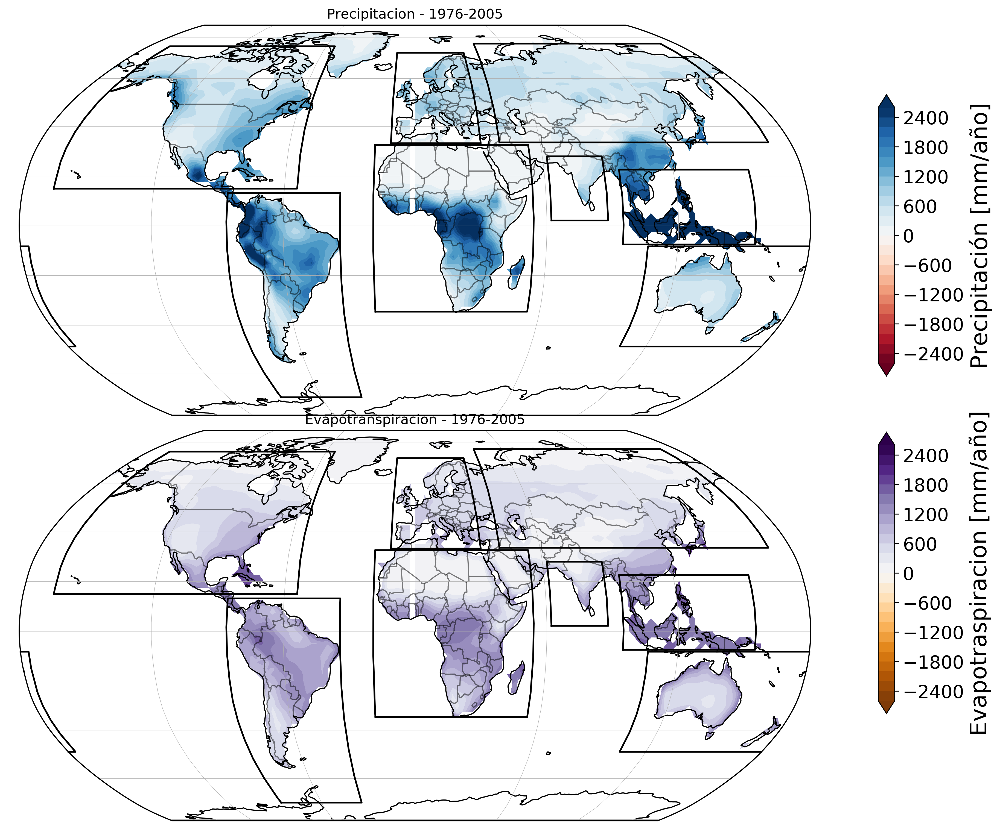

In [194]:
titulo1 = 'Precipitacion - 1976-2005'
titulo2 = 'Evapotranspiracion - 1976-2005'
clevels1 = np.arange(-2600,2800,200)
clevels2 = np.arange(-2600,2800,200)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_hist_ensmean.pr*mascara
dato2 = ev_hist_ensmean.evspsbl*mascara
mapa(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2,cmap1,cmap2)
plt.savefig(path+'CMIP6_historico.png',bbox_inches='tight')


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


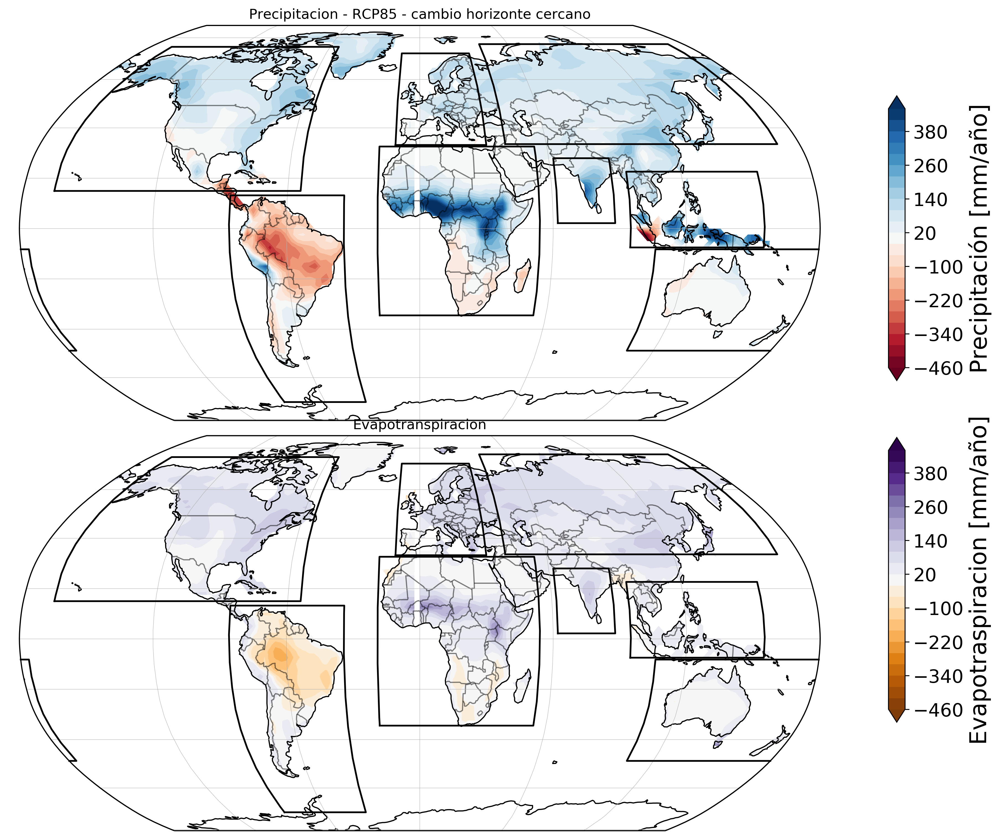

In [203]:
#Horizonte cercano cambio
titulo1 = 'Precipitacion - RCP85 - cambio horizonte cercano'
titulo2 = 'Evapotranspiracion'
clevels1 = np.arange(-460,500,40)
clevels2 = np.arange(-460,500,40)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_ssp585_mean_h1.pr*mascara - pr_hist_ensmean.pr*mascara
dato2 = ev_ssp585_mean_h1.evspsbl*mascara - ev_hist_ensmean.evspsbl*mascara
mapa(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2,cmap1,cmap2)
plt.savefig(path+'CMIP6_cambio_carcano_ssp585.png',bbox_inches='tight')


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


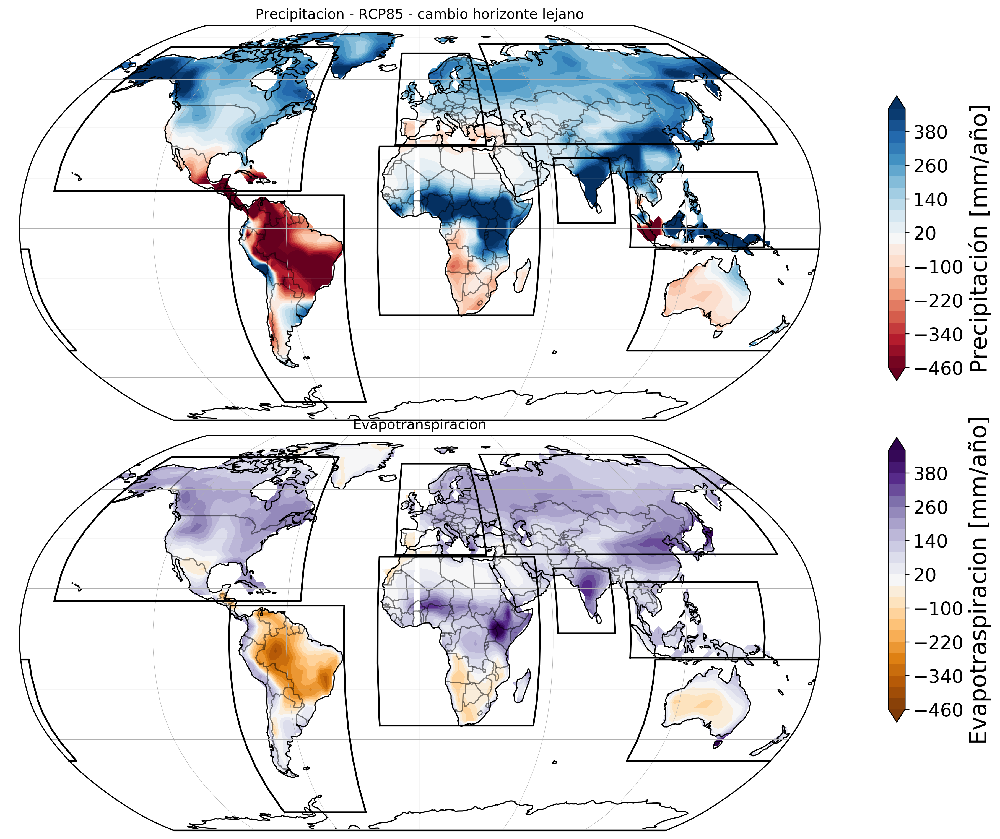

In [202]:
#Horizonte lejano cambio
titulo1 = 'Precipitacion - RCP85 - cambio horizonte lejano'
titulo2 = 'Evapotranspiracion'
clevels1 = np.arange(-460,500,40)
clevels2 = np.arange(-460,500,40)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_ssp585_mean_h2.pr*mascara - pr_hist_ensmean.pr*mascara
dato2 = ev_ssp585_mean_h2.evspsbl*mascara - ev_hist_ensmean.evspsbl*mascara
mapa(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2,cmap1,cmap2)
plt.savefig(path+'CMIP6_cambio_lejano_ssp585.png',bbox_inches='tight')


/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


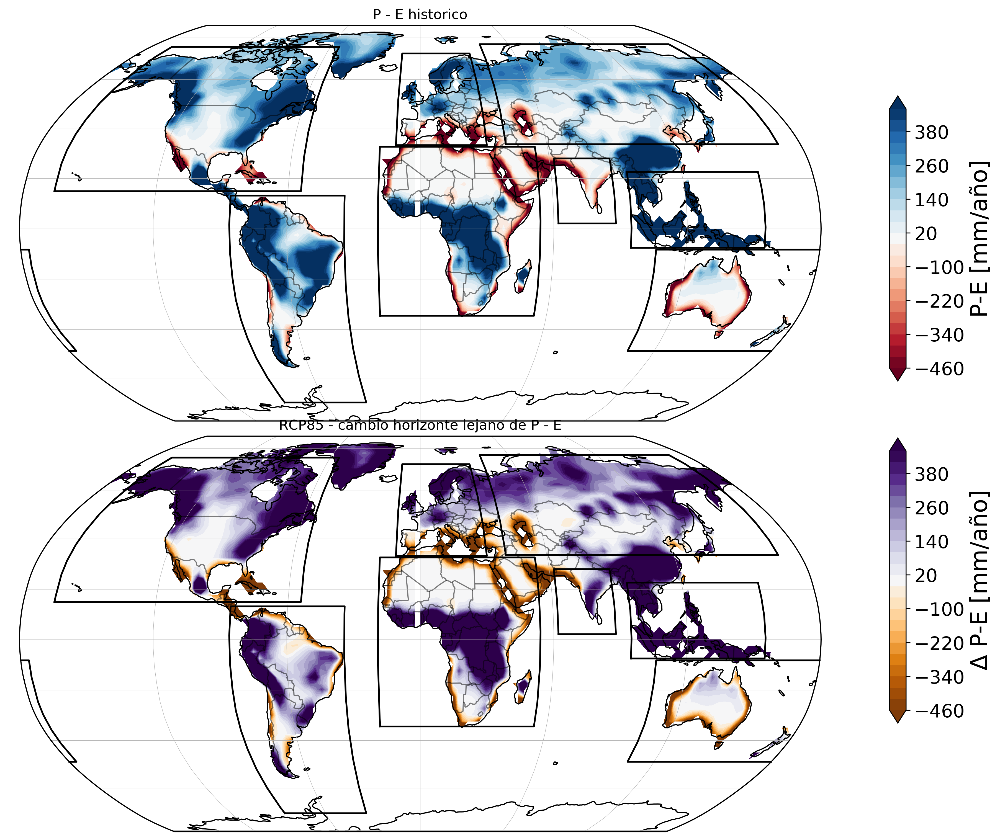

In [206]:
#Horizonte lejano cambio
titulo1 = 'P - E historico'
titulo2 = 'RCP85 - cambio horizonte lejano de P - E'
clevels1 = np.arange(-460,500,40)
clevels2 = np.arange(-460,500,40)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 =  pr_hist_ensmean.pr*mascara - ev_hist_ensmean.evspsbl*mascara
dato2 = pr_ssp585_mean_h2.pr*mascara - ev_ssp585_mean_h2.evspsbl*mascara 
mapa(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2,cmap1,cmap2)
plt.savefig(path+'CMIP6_P_E_hist_cambio.png',bbox_inches='tight')


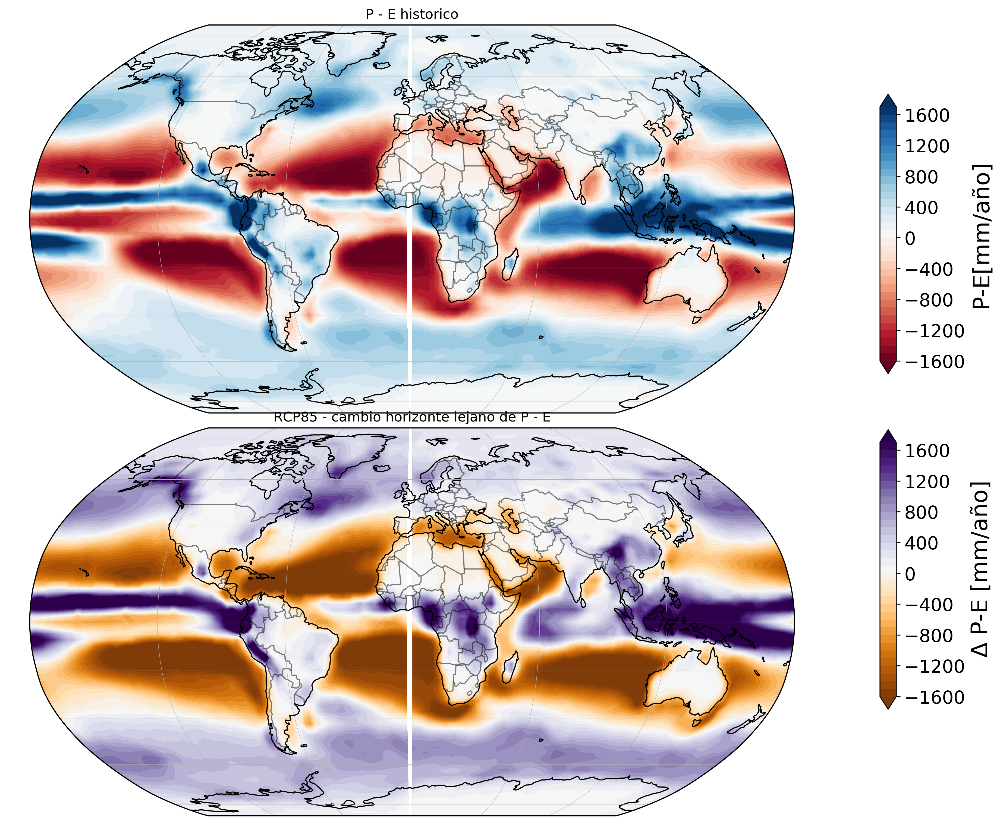

In [210]:
titulo1 = 'P - E historico'
titulo2 = 'RCP85 - cambio horizonte lejano de P - E'
clevels1 = np.arange(-1600,1800,100)
clevels2 = np.arange(-1600,1800,100)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 =  pr_hist_ensmean.pr- ev_hist_ensmean.evspsbl
dato2 =  pr_ssp585_mean_h2.pr - ev_ssp585_mean_h2.evspsbl
mapa_simple(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2)
plt.savefig(path+'CMIP6_cambios_hist_todo.png',bbox_inches='tight')

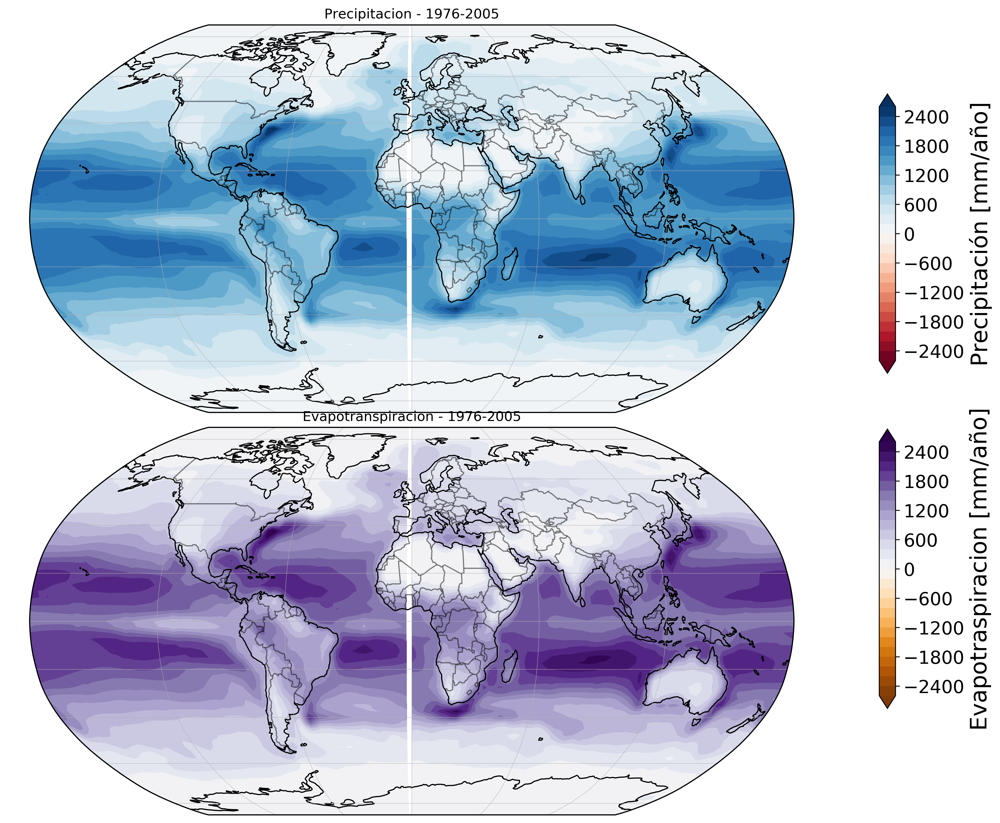

In [179]:
titulo1 = 'Precipitacion - 1976-2005'
titulo2 = 'Evapotranspiracion - 1976-2005'
clevels1 = np.arange(-2600,2800,200)
clevels2 = np.arange(-2600,2800,200)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_hist_ensmean.pr 
dato2 = ev_hist_ensmean.evspsbl
mapa_simple(dato1.mean(dim='time'),dato2.mean(dim='time'),titulo1,titulo2,clevels1,clevels2)
plt.savefig(path+'CMIP6_historico.png',bbox_inches='tight')


In [183]:
pr_hist_ensmean = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_historical_ensmean_2.5_anu.nc')
pr_hist_ensmean['time'] = time['time']
pr_ssp126_mean_h1 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp126_ensmeani1p1f1_2020-2049_2.5_anu.nc')
pr_ssp126_mean_h1['time'] = time['time']
pr_ssp126_mean_h2 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp126_ensmeani1p1f1_2070-2099_2.5_anu.nc')
pr_ssp126_mean_h2['time'] = time['time']
pr_ssp585_mean_h1 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp585_ensmeani1p1f1_2020-2049_2.5_anu.nc')
pr_ssp585_mean_h1['time'] = time['time']
pr_ssp585_mean_h2 = xr.open_dataset(path2+'/CanESM5/pr_Amon_CanESM5_ssp585_ensmeani1p1f1_2070-2099_2.5_anu.nc')
pr_ssp585_mean_h2['time'] = time['time']

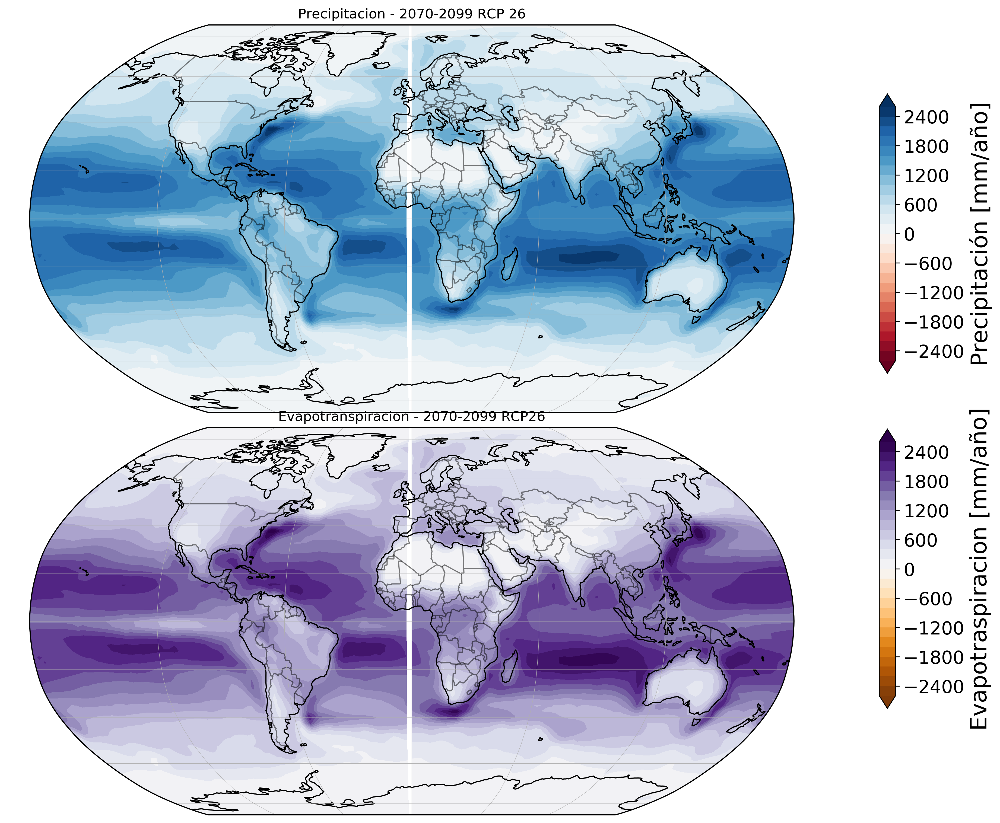

In [180]:
titulo1 = 'Precipitacion - 2070-2099 RCP 26'
titulo2 = 'Evapotranspiracion - 2070-2099 RCP26'
clevels1 = np.arange(-2600,2800,200)
clevels2 = np.arange(-2600,2800,200)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_ssp126_mean_h2.pr
dato1 = ev_ssp126_mean_h2.evspsbl
mapa_simple(dato1.mean(dim='time'),dato1.mean(dim='time'),titulo1,titulo2,clevels1,clevels2)
plt.savefig(path+'CMIP6_rcp126_h2.png',bbox_inches='tight')


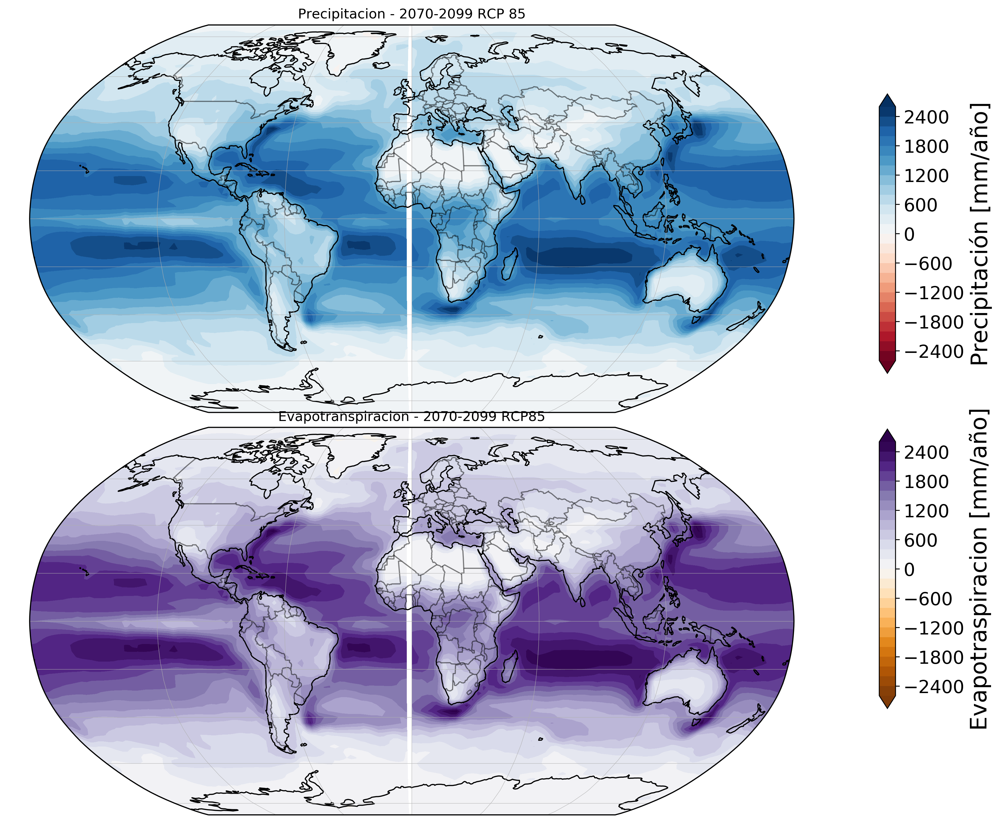

In [181]:
titulo1 = 'Precipitacion - 2070-2099 RCP 85'
titulo2 = 'Evapotranspiracion - 2070-2099 RCP85'
clevels1 = np.arange(-2600,2800,200)
clevels2 = np.arange(-2600,2800,200)
cmap1 = 'RdBu'
cmap2 = 'PuOr'
dato1 = pr_ssp585_mean_h2.pr
dato1 = ev_ssp585_mean_h2.evspsbl
mapa_simple(dato1.mean(dim='time'),dato1.mean(dim='time'),titulo1,titulo2,clevels1,clevels2)
plt.savefig(path+'CMIP6_rcp585_h2.png',bbox_inches='tight')


In [212]:


#Tabla continentes 
box_coords = [(30,180,30,80),(345,360,30,75),(0,35,30,75),(185,315,10,80),(270,330,-78,20),(335,360,-40,38),(0,60,-40,38),(100,190,-52,-5),(60,90,0,30),(90,160,-10,25)]
box_names = ['Asia','Europa1','Europa2','America del Norte','Sudamerica','Africa1','Africa2','Australasia Sur','India','Australasia Norte']

#Funciones
def bandas_cont(dato,dato_values,lat1,lat2,lon1,lon2):
    dato = dato.sel(lat=slice(lat1,lat2)).sel(lon=slice(lon1,lon2))
    weights = np.cos(np.deg2rad(dato.lat))
    aux = dato_values*86400*365
    aux = aux.mean(dim='time')
    aux = aux.mean(dim='lon')*weights
    area = sum(weights)
    aux_weight = aux.sum(dim='lat')/area
    return aux_weight/(86400*365)

#Precip
def valores_cont(box_coords,dato,datovalues,valor):
    Asia = bandas_cont(dato,datovalues,box_coords[0][2],box_coords[0][3],box_coords[0][0],box_coords[0][1])
    Europa = (bandas_cont(dato,datovalues,box_coords[1][2],box_coords[1][3],box_coords[1][0],box_coords[1][1]) + bandas_cont(dato,datovalues,box_coords[2][2],box_coords[2][3],box_coords[2][0],box_coords[2][1]))/2
    ANorte = bandas_cont(dato,datovalues,box_coords[3][2],box_coords[3][3],box_coords[3][0],box_coords[3][1])
    Asur = bandas_cont(dato,datovalues,box_coords[4][2],box_coords[4][3],box_coords[4][0],box_coords[4][1])
    Africa = (bandas_cont(dato,datovalues,box_coords[5][2],box_coords[5][3],box_coords[5][0],box_coords[5][1]) + bandas_cont(dato,datovalues,box_coords[6][2],box_coords[6][3],box_coords[6][0],box_coords[6][1]))/2
    Australasia_sur = bandas_cont(dato,datovalues,box_coords[7][2],box_coords[7][3],box_coords[7][0],box_coords[7][1])
    India = bandas_cont(dato,datovalues,box_coords[8][2],box_coords[8][3],box_coords[8][0],box_coords[8][1])
    Australasia_norte = bandas_cont(dato,datovalues,box_coords[9][2],box_coords[9][3],box_coords[9][0],box_coords[9][1])
    return {'Asia':Asia.values,'Europa':Europa.values,'Anorte':ANorte.values,'Asur':Asur.values,'Africa':Africa.values,'Australasia_sur':Australasia_sur.values,'India':India.values,'Australasia_norte':Australasia_norte.values,'valor':valor}


In [224]:
continentes

0

In [246]:

#Genero dataframe
precip = valores_cont(box_coords,pr_hist_ensmean,pr_hist_ensmean.pr*mascara,'precip')
precip = pd.DataFrame(data = precip,index=['hist'])

ev = valores_cont(box_coords,ev_hist_ensmean,ev_hist_ensmean.evspsbl*mascara,'evspsbl')
ev = pd.DataFrame(data = ev,index=['hist'])

p = precip.drop(labels='valor',axis=1)
e = ev.drop(labels='valor',axis=1)

p_menos_e = p - e
p_menos_e['valor'] = 'p_menos_e'

e_sobre_p = e/p
e_sobre_p['valor'] = 'e_sobre_p'

p_percent_e = (p-e)/p
p_percent_e['valor'] = 'p_percent_e'

continentes = pd.concat([precip,ev],axis=0)
continentes = pd.concat([continentes,p_menos_e,e_sobre_p,p_percent_e],axis=0)
continentes = round(continentes,3)



/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nan

In [248]:

#Genero dataframe
#Futuro 
precip_h1 = valores_cont(box_coords,pr_ssp585_mean_h1,pr_ssp585_mean_h1.pr*mascara,'precip')
precip_h1 = pd.DataFrame(data = precip_h1,index=['rcp85_h1'])

ev_h1 = valores_cont(box_coords,ev_ssp585_mean_h1,ev_ssp585_mean_h1.evspsbl*mascara,'evspsbl')
ev_h1 = pd.DataFrame(data = ev_h1,index=['rcp85_h1'])

p_h1 = precip_h1.drop(labels='valor',axis=1)
e_h1 = ev_h1.drop(labels='valor',axis=1)

p_menos_e_h1 = p_h1 - e_h1
p_menos_e_h1['valor'] = 'P-E'

p_sobre_e_h1 = e_h1/p_h1
p_sobre_e_h1['valor'] = 'E/P'

p_percent_e_h1 = (p_h1-e_h1)/p_h1
p_percent_e_h1['valor'] = '(P-E)/P'

#continentes = pd.concat([precip,ev],axis=0)
continentes_h1 = pd.concat([precip_h1,ev_h1,p_menos_e_h1,p_sobre_e_h1,p_percent_e_h1],axis=0)
continentes_h1 = round(continentes_h1,3)
continentes.to_csv(path+'tabla_continentes_RCP85_carcaCMIP6.txt')

/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nan

In [249]:

#Genero dataframe
#Futuro 
precip_h2 = valores_cont(box_coords,pr_ssp585_mean_h2,pr_ssp585_mean_h2.pr*mascara,'precip')
precip_h2 = pd.DataFrame(data = precip_h2,index=['rcp85_h1'])

ev_h2 = valores_cont(box_coords,ev_ssp585_mean_h2,ev_ssp585_mean_h2.evspsbl*mascara,'evspsbl')
ev_h2 = pd.DataFrame(data = ev_h2,index=['rcp85_h1'])

p_h2 = precip_h2.drop(labels='valor',axis=1)
e_h2 = ev_h2.drop(labels='valor',axis=1)

p_menos_e_h2 = p_h2 - e_h2
p_menos_e_h2['valor'] = 'P-E'

p_sobre_e_h2 = e_h2/p_h2
p_sobre_e_h2['valor'] = 'E/P'

p_percent_e_h2 = (p_h2-e_h2)/p_h2
p_percent_e_h2['valor'] = '(P-E)/P'

#continentes = pd.concat([precip,ev],axis=0)
continentes_h2 = pd.concat([precip_h2,ev_h2,p_menos_e_h2,p_sobre_e_h2,p_percent_e_h2],axis=0)
continentes_h2 = round(continentes_h2,3)
continentes.to_csv(path+'tabla_continentes_RCP85_lejosCMIP6.txt')

/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tabu/anaconda3/envs/juliapy/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nan

,Asia,Europa,Anorte,Asur,Africa,Australasia_sur,India,Australasia_norte
rcp85_h1,769.794812,777.796141,814.586521,1184.399024,1248.702528,1111.769567,1342.272109,1665.729427


In [270]:
continentes = round(continentes,3)
continentes[0:1]

,Asia,Europa,Anorte,Asur,Africa,Australasia_sur,India,Australasia_norte,valor
hist,577.652,588.196,661.918,1173.762,1216.803,1182.792,1217.471,1558.084,precip


In [279]:
a = continentes_h2.reset_index().drop(labels='index',axis=1).drop(labels='valor',axis=1) 

In [273]:
b = continentes.reset_index().drop(labels='index',axis=1).drop(labels='valor',axis=1) 

In [281]:
pd.DataFrame(data = (a - b))

,Asia,Europa,Anorte,Asur,Africa,Australasia_sur,India,Australasia_norte
0,192.143,189.600,152.669,10.637,31.900,-71.022,124.801,107.645
1,142.886,145.380,131.231,43.369,55.139,16.769,106.187,81.090
2,49.257,44.221,21.438,-32.732,-23.239,-87.792,18.613,26.556
3,0.005,0.008,0.003,0.030,0.024,0.068,0.010,0.004
4,-0.005,-0.008,-0.003,-0.030,-0.024,-0.068,-0.010,-0.004
